In [1]:
import numpy as np # library to handle data in a vectorized manner

import pandas as pd # library for data analsysis
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

import json # library to handle JSON files

from geopy.geocoders import Nominatim # convert an address into latitude and longitude values

import requests # library to handle requests
from pandas.io.json import json_normalize # tranform JSON file into a pandas dataframe

# Matplotlib and associated plotting modules
import matplotlib.cm as mplt
import matplotlib.colors as colors

# import k-means from clustering stage
from sklearn.cluster import KMeans

import folium # map rendering library

print('Libraries imported.')

Libraries imported.


## Data Preprocessing

In [2]:
df=pd.read_csv('Accidental_Drug_Related_Deaths_2012-2018.csv')


FileNotFoundError: ignored

In [4]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [3]:
from google.colab import drive
drive.mount('/content/drive')
link="https://drive.google.com/file/d/1QZVj7hTurms-LouZ-c4SJA1AXwTP3CqT/view?usp=sharing"
id=link.split("/")[5]
pd.read_csv(link)


Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/drive


ParserError: ignored

In [5]:
from google.colab import files
data_to_load = files.upload()

Saving Accidental_Drug_Related_Deaths_2012-2018.csv to Accidental_Drug_Related_Deaths_2012-2018.csv


In [6]:
import io
df = pd.read_csv(io.BytesIO(data_to_load['Accidental_Drug_Related_Deaths_2012-2018.csv']))
df.head()

,ID,Date,DateType,Age,Sex,Race,ResidenceCity,ResidenceCounty,ResidenceState,DeathCity,DeathCounty,Location,LocationifOther,DescriptionofInjury,InjuryPlace,InjuryCity,InjuryCounty,InjuryState,COD,OtherSignifican,Heroin,Cocaine,Fentanyl,FentanylAnalogue,Oxycodone,Oxymorphone,Ethanol,Hydrocodone,Benzodiazepine,Methadone,Amphet,Tramad,Morphine_NotHeroin,Hydromorphone,Other,OpiateNOS,AnyOpioid,MannerofDeath,DeathCityGeo,ResidenceCityGeo,InjuryCityGeo
0,14-0273,06/28/2014 12:00:00 AM,DateReported,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,substance,NaN,NaN,NaN,NaN,"Acute fent, hydrocod, benzodiazepine",NaN,NaN,NaN,Y,NaN,NaN,NaN,NaN,Y,Y,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Accident,"CT\n(41.575155, -72.738288)","CT\n(41.575155, -72.738288)","CT\n(41.575155, -72.738288)"
1,13-0102,03/21/2013 12:00:00 AM,DateofDeath,48.0,Male,Black,NORWALK,NaN,NaN,NORWALK,FAIRFIELD,Hospital,NaN,NaN,NaN,NaN,NaN,NaN,Cocaine Intoxication,NaN,NaN,Y,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Accident,"Norwalk, CT\n(41.11805, -73.412906)","NORWALK, CT\n(41.11805, -73.412906)","CT\n(41.575155, -72.738288)"
2,16-0165,03/13/2016 12:00:00 AM,DateofDeath,30.0,Female,White,SANDY HOOK,FAIRFIELD,CT,DANBURY,NaN,Hospital,NaN,Substance Abuse,Unknown,UNKNOWN,NaN,NaN,Acute Heroin and Cocaine Intoxication,NaN,Y,Y,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Y,Accident,"Danbury, CT\n(41.393666, -73.451539)","SANDY HOOK, CT\n(41.419998, -73.282501)",NaN
3,16-0208,03/31/2016 12:00:00 AM,DateofDeath,23.0,Male,White,RYE,WESTCHESTER,NY,GREENWICH,NaN,Hospital,NaN,substance abuse,Residence,RYE,NaN,NaN,Acute Fentanyl and Morphine Intoxication,NaN,Y,NaN,Y,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Y,Accident,"Greenwich, CT\n(41.026526, -73.628549)",NaN,NaN
4,13-0052,02/13/2013 12:00:00 AM,DateofDeath,22.0,Male,"Asian, Other",FLUSHING,QUEENS,NaN,GREENWICH,FAIRFIELD,Hospital,NaN,Transdermal Absorption,Other,NaN,NaN,NaN,Fentanyl Intoxication,NaN,NaN,NaN,Y,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Accident,"Greenwich, CT\n(41.026526, -73.628549)",NaN,"CT\n(41.575155, -72.738288)"


# New Section

In [7]:
df.head(50)

,ID,Date,DateType,Age,Sex,Race,ResidenceCity,ResidenceCounty,ResidenceState,DeathCity,DeathCounty,Location,LocationifOther,DescriptionofInjury,InjuryPlace,InjuryCity,InjuryCounty,InjuryState,COD,OtherSignifican,Heroin,Cocaine,Fentanyl,FentanylAnalogue,Oxycodone,Oxymorphone,Ethanol,Hydrocodone,Benzodiazepine,Methadone,Amphet,Tramad,Morphine_NotHeroin,Hydromorphone,Other,OpiateNOS,AnyOpioid,MannerofDeath,DeathCityGeo,ResidenceCityGeo,InjuryCityGeo
0,14-0273,06/28/2014 12:00:00 AM,DateReported,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,substance,NaN,NaN,NaN,NaN,"Acute fent, hydrocod, benzodiazepine",NaN,NaN,NaN,Y,NaN,NaN,NaN,NaN,Y,Y,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Accident,"CT\n(41.575155, -72.738288)","CT\n(41.575155, -72.738288)","CT\n(41.575155, -72.738288)"
1,13-0102,03/21/2013 12:00:00 AM,DateofDeath,48.0,Male,Black,NORWALK,NaN,NaN,NORWALK,FAIRFIELD,Hospital,NaN,NaN,NaN,NaN,NaN,NaN,Cocaine Intoxication,NaN,NaN,Y,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Accident,"Norwalk, CT\n(41.11805, -73.412906)","NORWALK, CT\n(41.11805, -73.412906)","CT\n(41.575155, -72.738288)"
2,16-0165,03/13/2016 12:00:00 AM,DateofDeath,30.0,Female,White,SANDY HOOK,FAIRFIELD,CT,DANBURY,NaN,Hospital,NaN,Substance Abuse,Unknown,UNKNOWN,NaN,NaN,Acute Heroin and Cocaine Intoxication,NaN,Y,Y,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Y,Accident,"Danbury, CT\n(41.393666, -73.451539)","SANDY HOOK, CT\n(41.419998, -73.282501)",NaN
3,16-0208,03/31/2016 12:00:00 AM,DateofDeath,23.0,Male,White,RYE,WESTCHESTER,NY,GREENWICH,NaN,Hospital,NaN,substance abuse,Residence,RYE,NaN,NaN,Acute Fentanyl and Morphine Intoxication,NaN,Y,NaN,Y,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Y,Accident,"Greenwich, CT\n(41.026526, -73.628549)",NaN,NaN
4,13-0052,02/13/2013 12:00:00 AM,DateofDeath,22.0,Male,"Asian, Other",FLUSHING,QUEENS,NaN,GREENWICH,FAIRFIELD,Hospital,NaN,Transdermal Absorption,Other,NaN,NaN,NaN,Fentanyl Intoxication,NaN,NaN,NaN,Y,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Accident,"Greenwich, CT\n(41.026526, -73.628549)",NaN,"CT\n(41.575155, -72.738288)"
5,14-0277,06/29/2014 12:00:00 AM,DateofDeath,23.0,Male,White,BRISTOL,NaN,NaN,BRISTOL,HARTFORD,Residence,NaN,Inhalation,Residence,NaN,NaN,NaN,Heroin Intoxication,NaN,Y,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Accident,"BRISTOL, CT\n(41.673037, -72.945791)","BRISTOL, CT\n(41.673037, -72.945791)","CT\n(41.575155, -72.738288)"
6,12-0205,08/12/2012 12:00:00 AM,DateofDeath,21.0,Female,White,WEST HARTFORD,HARTFORD,NaN,WEST HARTFORD,HARTFORD,Residence,NaN,Used Heroin,Residence,NaN,NaN,NaN,Heroin Toxicity,NaN,Y,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Accident,"WEST HARTFORD, CT\n(41.762008, -72.741807)","WEST HARTFORD, CT\n(41.762008, -72.741807)","CT\n(41.575155, -72.738288)"
7,13-0404,11/10/2013 12:00:00 AM,DateofDeath,40.0,Female,White,HAMDEN,NEW HAVEN,NaN,NEW HAVEN,NEW HAVEN,Hospital,NaN,NaN,NaN,NaN,NaN,NaN,Complications of Cocaine Intoxication,NaN,NaN,Y,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Accident,"New Haven, CT\n(41.308252, -72.924161)","HAMDEN, CT\n(41.382918, -72.907743)","CT\n(41.575155, -72.738288)"
8,12-0107,04/25/2012 12:00:00 AM,DateofDeath,40.0,Male,White,EAST HARTFORD,HARTFORD,NaN,EAST HARTFORD,HARTFORD,Residence,NaN,Used Heroin,Residence,NaN,NaN,NaN,Heroin Toxicity,NaN,Y,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Accident,"EAST HARTFORD, CT\n(41.769319, -72.643785)","EAST HARTFORD, CT\n(41.769319, -72.643785)","CT\n(41.575155, -72.738288)"
9,13-0161,05/15/2013 12:00:00 AM,DateofDeath,50.0,Male,White,MONTVILLE,NEW LONDON,NaN,MONTVILLE,NEW LONDON,Residence,NaN,Ingestion,Residence,NaN,NaN,NaN,Oxycodone Intoxication,NaN,NaN,NaN,NaN,NaN,Y,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Accident,"MONTVILLE, CT\n(41.45303, -72.136336)","MONTVILLE, CT\n(41.45303, -72.136336)","CT\n(41.575155, -72.738288)"


In [8]:
columns_=df.columns.to_list()

In [9]:
for a in columns_:
    print (a,'is',type(a))

ID is <class 'str'>
Date is <class 'str'>
DateType is <class 'str'>
Age is <class 'str'>
Sex is <class 'str'>
Race is <class 'str'>
ResidenceCity is <class 'str'>
ResidenceCounty is <class 'str'>
ResidenceState is <class 'str'>
DeathCity is <class 'str'>
DeathCounty is <class 'str'>
Location is <class 'str'>
LocationifOther is <class 'str'>
DescriptionofInjury is <class 'str'>
InjuryPlace is <class 'str'>
InjuryCity is <class 'str'>
InjuryCounty is <class 'str'>
InjuryState is <class 'str'>
COD is <class 'str'>
OtherSignifican is <class 'str'>
Heroin is <class 'str'>
Cocaine is <class 'str'>
Fentanyl is <class 'str'>
FentanylAnalogue is <class 'str'>
Oxycodone is <class 'str'>
Oxymorphone is <class 'str'>
Ethanol is <class 'str'>
Hydrocodone is <class 'str'>
Benzodiazepine is <class 'str'>
Methadone is <class 'str'>
Amphet is <class 'str'>
Tramad is <class 'str'>
Morphine_NotHeroin is <class 'str'>
Hydromorphone is <class 'str'>
Other is <class 'str'>
OpiateNOS is <class 'str'>
AnyOpio

In [10]:
manke=df[columns_].isnull().sum()/len(df)*100
np.around(manke)

ID                       0.0
Date                     0.0
DateType                 0.0
Age                      0.0
Sex                      0.0
Race                     0.0
ResidenceCity            3.0
ResidenceCounty         16.0
ResidenceState          30.0
DeathCity                0.0
DeathCounty             22.0
Location                 0.0
LocationifOther         88.0
DescriptionofInjury     15.0
InjuryPlace              1.0
InjuryCity              34.0
InjuryCounty            54.0
InjuryState             72.0
COD                      0.0
OtherSignifican         97.0
Heroin                  50.0
Cocaine                 70.0
Fentanyl                56.0
FentanylAnalogue        92.0
Oxycodone               88.0
Oxymorphone             98.0
Ethanol                 76.0
Hydrocodone             98.0
Benzodiazepine          74.0
Methadone               91.0
Amphet                  97.0
Tramad                  97.0
Morphine_NotHeroin      99.0
Hydromorphone          100.0
Other         

In [11]:
df['Race'].unique()

array([nan, 'Black', 'White', 'Asian, Other', 'Hispanic, White',
       'Asian Indian', 'Hispanic, Black', 'Unknown', 'Other', 'Chinese',
       'Native American, Other', 'Hawaiian'], dtype=object)

In [12]:
col=['Age','Sex','Race','ResidenceCity','DeathCity','InjuryCity','DeathCityGeo','ResidenceCityGeo','InjuryCityGeo']
print(type(col))

<class 'list'>


In [13]:
data=df[col]
a=data.shape
b=data.head(50)
b

,Age,Sex,Race,ResidenceCity,DeathCity,InjuryCity,DeathCityGeo,ResidenceCityGeo,InjuryCityGeo
0,NaN,NaN,NaN,NaN,NaN,NaN,"CT\n(41.575155, -72.738288)","CT\n(41.575155, -72.738288)","CT\n(41.575155, -72.738288)"
1,48.0,Male,Black,NORWALK,NORWALK,NaN,"Norwalk, CT\n(41.11805, -73.412906)","NORWALK, CT\n(41.11805, -73.412906)","CT\n(41.575155, -72.738288)"
2,30.0,Female,White,SANDY HOOK,DANBURY,UNKNOWN,"Danbury, CT\n(41.393666, -73.451539)","SANDY HOOK, CT\n(41.419998, -73.282501)",NaN
3,23.0,Male,White,RYE,GREENWICH,RYE,"Greenwich, CT\n(41.026526, -73.628549)",NaN,NaN
4,22.0,Male,"Asian, Other",FLUSHING,GREENWICH,NaN,"Greenwich, CT\n(41.026526, -73.628549)",NaN,"CT\n(41.575155, -72.738288)"
5,23.0,Male,White,BRISTOL,BRISTOL,NaN,"BRISTOL, CT\n(41.673037, -72.945791)","BRISTOL, CT\n(41.673037, -72.945791)","CT\n(41.575155, -72.738288)"
6,21.0,Female,White,WEST HARTFORD,WEST HARTFORD,NaN,"WEST HARTFORD, CT\n(41.762008, -72.741807)","WEST HARTFORD, CT\n(41.762008, -72.741807)","CT\n(41.575155, -72.738288)"
7,40.0,Female,White,HAMDEN,NEW HAVEN,NaN,"New Haven, CT\n(41.308252, -72.924161)","HAMDEN, CT\n(41.382918, -72.907743)","CT\n(41.575155, -72.738288)"
8,40.0,Male,White,EAST HARTFORD,EAST HARTFORD,NaN,"EAST HARTFORD, CT\n(41.769319, -72.643785)","EAST HARTFORD, CT\n(41.769319, -72.643785)","CT\n(41.575155, -72.738288)"
9,50.0,Male,White,MONTVILLE,MONTVILLE,NaN,"MONTVILLE, CT\n(41.45303, -72.136336)","MONTVILLE, CT\n(41.45303, -72.136336)","CT\n(41.575155, -72.738288)"


In [14]:
data.isnull().sum()

Age                    3
Sex                    6
Race                  13
ResidenceCity        173
DeathCity              5
InjuryCity          1756
DeathCityGeo           0
ResidenceCityGeo      93
InjuryCityGeo         78
dtype: int64

In [15]:
dropi=['Age','Sex','Race','ResidenceCityGeo','InjuryCityGeo','ResidenceCity','InjuryCity']

In [16]:
data.dtypes

Age                 float64
Sex                  object
Race                 object
ResidenceCity        object
DeathCity            object
InjuryCity           object
DeathCityGeo         object
ResidenceCityGeo     object
InjuryCityGeo        object
dtype: object

In [17]:
data.dropna(subset=['Age','Sex','Race'],axis=0)

,Age,Sex,Race,ResidenceCity,DeathCity,InjuryCity,DeathCityGeo,ResidenceCityGeo,InjuryCityGeo
1,48.0,Male,Black,NORWALK,NORWALK,NaN,"Norwalk, CT\n(41.11805, -73.412906)","NORWALK, CT\n(41.11805, -73.412906)","CT\n(41.575155, -72.738288)"
2,30.0,Female,White,SANDY HOOK,DANBURY,UNKNOWN,"Danbury, CT\n(41.393666, -73.451539)","SANDY HOOK, CT\n(41.419998, -73.282501)",NaN
3,23.0,Male,White,RYE,GREENWICH,RYE,"Greenwich, CT\n(41.026526, -73.628549)",NaN,NaN
4,22.0,Male,"Asian, Other",FLUSHING,GREENWICH,NaN,"Greenwich, CT\n(41.026526, -73.628549)",NaN,"CT\n(41.575155, -72.738288)"
5,23.0,Male,White,BRISTOL,BRISTOL,NaN,"BRISTOL, CT\n(41.673037, -72.945791)","BRISTOL, CT\n(41.673037, -72.945791)","CT\n(41.575155, -72.738288)"
6,21.0,Female,White,WEST HARTFORD,WEST HARTFORD,NaN,"WEST HARTFORD, CT\n(41.762008, -72.741807)","WEST HARTFORD, CT\n(41.762008, -72.741807)","CT\n(41.575155, -72.738288)"
7,40.0,Female,White,HAMDEN,NEW HAVEN,NaN,"New Haven, CT\n(41.308252, -72.924161)","HAMDEN, CT\n(41.382918, -72.907743)","CT\n(41.575155, -72.738288)"
8,40.0,Male,White,EAST HARTFORD,EAST HARTFORD,NaN,"EAST HARTFORD, CT\n(41.769319, -72.643785)","EAST HARTFORD, CT\n(41.769319, -72.643785)","CT\n(41.575155, -72.738288)"
9,50.0,Male,White,MONTVILLE,MONTVILLE,NaN,"MONTVILLE, CT\n(41.45303, -72.136336)","MONTVILLE, CT\n(41.45303, -72.136336)","CT\n(41.575155, -72.738288)"
10,26.0,Female,"Hispanic, White",NaN,STRATFORD,NaN,"STRATFORD, CT\n(41.200888, -73.131323)","CT\n(41.575155, -72.738288)","CT\n(41.575155, -72.738288)"


In [18]:
import re

In [19]:
def clean(a):
    clean_=re.findall('[-+]?([0-9]*\.[0-9]+|[0-9]+)',str(a))
    return clean_

In [20]:
ab=data['ResidenceCityGeo'].apply(clean)
def cleaning(k):
    if(len(k)<2):
        k.append(0)
        k.append(0)
xxx=ab.apply(cleaning)

In [21]:
lat=[]
lon=[]
for i in range(len(ab)):
    lat.append(ab[i][0])
    lon.append(ab[i][1])

In [22]:
data['lat_Residence']=lat
data['longi_Residence']=lon
data[['lat_Residence','longi_Residence']].head()

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


,lat_Residence,longi_Residence
0,41.575155,72.738288
1,41.11805,73.412906
2,41.419998,73.282501
3,0,0
4,0,0


In [23]:
ac=data['DeathCityGeo'].apply(clean)
xx1=ac.apply(cleaning)

In [24]:
latD=[]
lonD=[]
for i in range(len(ac)):
    latD.append(ac[i][0])
    lonD.append(ac[i][1])

In [25]:
data['lat_DeathCity']=latD
data['lon_DeathCity']=lonD
data[['lat_DeathCity','lon_DeathCity']].head()

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


,lat_DeathCity,lon_DeathCity
0,41.575155,72.738288
1,41.11805,73.412906
2,41.393666,73.451539
3,41.026526,73.628549
4,41.026526,73.628549


In [26]:
ad=data['InjuryCityGeo'].apply(clean)
xx2=ad.apply(cleaning)

In [27]:
latJ=[]
lonJ=[]
for i in range(len(ad)):
    latJ.append(ad[i][0])
    lonJ.append(ad[i][1])

In [28]:
data['lat_InjuryCity']=latJ
data['lon_InjuryCity']=lonJ
data[['lat_InjuryCity','lon_InjuryCity']].head()

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


,lat_InjuryCity,lon_InjuryCity
0,41.575155,72.738288
1,41.575155,72.738288
2,0,0
3,0,0
4,41.575155,72.738288


In [29]:
#data[['longi_Residence','lon_DeathCity','lon_InjuryCity']]*(-1)
data.dtypes

Age                 float64
Sex                  object
Race                 object
ResidenceCity        object
DeathCity            object
InjuryCity           object
DeathCityGeo         object
ResidenceCityGeo     object
InjuryCityGeo        object
lat_Residence        object
longi_Residence      object
lat_DeathCity        object
lon_DeathCity        object
lat_InjuryCity       object
lon_InjuryCity       object
dtype: object

In [30]:
data[['longi_Residence','lat_Residence','lon_DeathCity','lat_DeathCity','lon_InjuryCity','lat_InjuryCity']] =data[['longi_Residence','lat_Residence','lon_DeathCity','lat_DeathCity','lon_InjuryCity','lat_InjuryCity']].apply(pd.to_numeric) 

/usr/local/lib/python3.6/dist-packages/pandas/core/frame.py:2963: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self[k1] = value[k2]


In [31]:
data[['longi_Residence','lon_DeathCity','lon_InjuryCity']]=data[['longi_Residence','lon_DeathCity','lon_InjuryCity']]*(-1)

/usr/local/lib/python3.6/dist-packages/pandas/core/frame.py:2963: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self[k1] = value[k2]


In [32]:
data.head()

,Age,Sex,Race,ResidenceCity,DeathCity,InjuryCity,DeathCityGeo,ResidenceCityGeo,InjuryCityGeo,lat_Residence,longi_Residence,lat_DeathCity,lon_DeathCity,lat_InjuryCity,lon_InjuryCity
0,NaN,NaN,NaN,NaN,NaN,NaN,"CT\n(41.575155, -72.738288)","CT\n(41.575155, -72.738288)","CT\n(41.575155, -72.738288)",41.575155,-72.738288,41.575155,-72.738288,41.575155,-72.738288
1,48.0,Male,Black,NORWALK,NORWALK,NaN,"Norwalk, CT\n(41.11805, -73.412906)","NORWALK, CT\n(41.11805, -73.412906)","CT\n(41.575155, -72.738288)",41.118050,-73.412906,41.118050,-73.412906,41.575155,-72.738288
2,30.0,Female,White,SANDY HOOK,DANBURY,UNKNOWN,"Danbury, CT\n(41.393666, -73.451539)","SANDY HOOK, CT\n(41.419998, -73.282501)",NaN,41.419998,-73.282501,41.393666,-73.451539,0.000000,-0.000000
3,23.0,Male,White,RYE,GREENWICH,RYE,"Greenwich, CT\n(41.026526, -73.628549)",NaN,NaN,0.000000,-0.000000,41.026526,-73.628549,0.000000,-0.000000
4,22.0,Male,"Asian, Other",FLUSHING,GREENWICH,NaN,"Greenwich, CT\n(41.026526, -73.628549)",NaN,"CT\n(41.575155, -72.738288)",0.000000,-0.000000,41.026526,-73.628549,41.575155,-72.738288


In [33]:
data.dropna(subset=dropi,axis=0,inplace=True)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


In [34]:
data.reset_index(drop=True,inplace=True)

In [35]:
data.isnull().sum()

Age                 0
Sex                 0
Race                0
ResidenceCity       0
DeathCity           0
InjuryCity          0
DeathCityGeo        0
ResidenceCityGeo    0
InjuryCityGeo       0
lat_Residence       0
longi_Residence     0
lat_DeathCity       0
lon_DeathCity       0
lat_InjuryCity      0
lon_InjuryCity      0
dtype: int64

In [36]:
color_=list(data['Race'].unique())
color_.pop(1)
color_

['Black',
 'Hispanic, White',
 'Asian Indian',
 'Asian, Other',
 'Hispanic, Black',
 'Unknown',
 'Other',
 'Chinese',
 'Hawaiian']

In [37]:
data.replace(to_replace =color_, value ='colour',inplace=True)   

/usr/local/lib/python3.6/dist-packages/pandas/core/frame.py:4172: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  method=method,


In [38]:
data['Sex'].replace(to_replace ='colour', value ='Male',inplace=True)

/usr/local/lib/python3.6/dist-packages/pandas/core/generic.py:6746: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._update_inplace(new_data)


In [39]:
data.head()

,Age,Sex,Race,ResidenceCity,DeathCity,InjuryCity,DeathCityGeo,ResidenceCityGeo,InjuryCityGeo,lat_Residence,longi_Residence,lat_DeathCity,lon_DeathCity,lat_InjuryCity,lon_InjuryCity
0,29.0,Male,colour,NEW HAVEN,NEW HAVEN,NEW HAVEN,"NEW HAVEN, CT\n(41.308252, -72.924161)","NEW HAVEN, CT\n(41.308252, -72.924161)","NEW HAVEN, CT\n(41.308252, -72.924161)",41.308252,-72.924161,41.308252,-72.924161,41.308252,-72.924161
1,54.0,Male,White,MIDDLETOWN,MIDDLETOWN,MIDDLETOWN,"MIDDLETOWN, CT\n(41.544654, -72.651713)","MIDDLETOWN, CT\n(41.544654, -72.651713)","MIDDLETOWN, CT\n(41.544654, -72.651713)",41.544654,-72.651713,41.544654,-72.651713,41.544654,-72.651713
2,32.0,Male,White,WINDHAM,WINDHAM,WINDHAM,"Windham, CT\n(41.699744, -72.157703)","WINDHAM, CT\n(41.699744, -72.157703)","WINDHAM, CT\n(41.699744, -72.157703)",41.699744,-72.157703,41.699744,-72.157703,41.699744,-72.157703
3,39.0,Female,White,ANSONIA,DERBY,ANSONIA,"Derby, CT\n(41.322959, -73.089594)","ANSONIA, CT\n(41.34198, -73.078296)","ANSONIA, CT\n(41.34198, -73.078296)",41.341980,-73.078296,41.322959,-73.089594,41.341980,-73.078296
4,34.0,Male,White,COS COB,COS COB,COS COB,"COS COB, CT\n(41.037899, -73.599776)","COS COB, CT\n(41.037899, -73.599776)","COS COB, CT\n(41.037899, -73.599776)",41.037899,-73.599776,41.037899,-73.599776,41.037899,-73.599776


## Exploratory Data Analysis

In [40]:
import seaborn as sns
import matplotlib.pyplot as plt

/usr/local/lib/python3.6/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


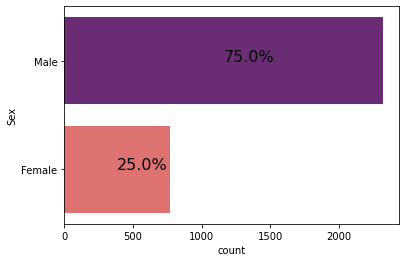

In [41]:
ax = sns.countplot(y='Sex', data=data,palette = 'magma')
total = len(data["Sex"])
for p in ax.patches:
        percentage = '{:.1f}%'.format(100 * p.get_width()/total)
        x = p.get_x() + p.get_width()/2
        y = p.get_y() + p.get_height()/2
        ax.annotate(percentage, (x, y),fontsize=16,color="black")

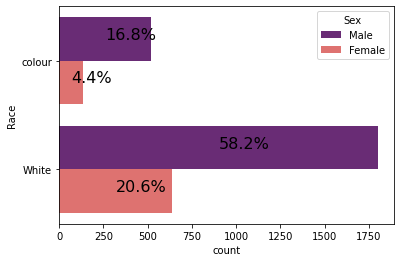

In [42]:
ax = sns.countplot(y='Race', hue='Sex', data=data,palette = 'magma')
total = len(data["Sex"])
for p in ax.patches:
        percentage = '{:.1f}%'.format(100 * p.get_width()/total)
        x = p.get_x() + p.get_width()/2
        y = p.get_y() + p.get_height()/2
        ax.annotate(percentage, (x, y),fontsize=16,color="black")

In [43]:
data['Age'].describe()

count    3093.000000
mean       42.283867
std        12.394924
min        15.000000
25%        32.000000
50%        42.000000
75%        52.000000
max        84.000000
Name: Age, dtype: float64

In [44]:
address = 'Chicago'

geolocator = Nominatim(user_agent="ny_explorer")
location = geolocator.geocode(address)
latitude = location.latitude
longitude = location.longitude
print('The geograpical coordinate of chicago are {}, {}.'.format(latitude, longitude))

The geograpical coordinate of chicago are 41.8755616, -87.6244212.


In [45]:
# create map of the residence using latitude and longitude values
map_residence = folium.Map(location=[latitude, longitude], zoom_start=10)

# add markers to map
for lat, lng, Residencecity in zip(data['lat_Residence'], data['longi_Residence'], data['ResidenceCity']):
    label = '{}'.format(Residencecity)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker([lat, lng],radius=5,popup=label,color='green',fill=True,fill_color='#3186cc',fill_opacity=0.7,parse_html=False).add_to(map_residence)  
    
map_residence

In [49]:
# create map of the Death City using latitude and longitude values
map_death = folium.Map(location=[latitude, longitude], zoom_start=5)

# add markers to map
for lat, lng, deathcity in zip(data['lat_DeathCity'], data['lon_DeathCity'], data['DeathCity']):
    label = '{}'.format(deathcity)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker([lat, lng],radius=5,popup=label,color='red',fill=True,fill_color='#3186cc',fill_opacity=0.7,parse_html=False).add_to(map_death)  
    
map_death

In [47]:
# create map of the Injury City using latitude and longitude values
map_Injury = folium.Map(location=[latitude, longitude], zoom_start=5)

# add markers to map
for lat, lng, Injurycity in zip(data['lat_InjuryCity'], data['lon_InjuryCity'], data['InjuryCity']):
    label = '{}'.format(deathcity)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker([lat, lng],radius=5,popup=label,color='blue',fill=True,fill_color='#3186cc',fill_opacity=0.7,parse_html=False).add_to(map_Injury)  
    
map_Injury

In [50]:
data['InjuryCity']=data['InjuryCity']+'_Injury'

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


In [52]:
data['DeathCity']=data['DeathCity']+'_Death'
data['DeathCity'].head()

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


0     NEW HAVEN_Death
1    MIDDLETOWN_Death
2       WINDHAM_Death
3         DERBY_Death
4       COS COB_Death
Name: DeathCity, dtype: object

In [54]:
list1=['Age','Sex','Race','ResidenceCity','DeathCity','InjuryCity']

In [55]:
data_onehot=data[list1]

In [56]:
# one hot encoding
data_ = pd.get_dummies(data_onehot[['Sex','Race','DeathCity','InjuryCity']], prefix="", prefix_sep="")
data_.head()

,Female,Male,White,colour,06340_Death,AMSTON_Death,ANDOVER_Death,ANSONIA_Death,ASHFORD_Death,AVON_Death,BALTIC_Death,BANTAM_Death,BEACON FALLS_Death,BERLIN_Death,BETHANY_Death,BETHEL_Death,BETHLEHEM_Death,BLOOMFIELD_Death,BOLTON_Death,BRANFORD_Death,BRIDGEPORT_Death,BRIDGEWATER_Death,BRISTOL_Death,BROAD BROOK_Death,BROOKFIELD_Death,BROOKLYN_Death,BURLINGTON_Death,CANTERBURY_Death,CANTON_Death,CENTRAL VILLAGE_Death,CHAPLIN_Death,CHESHIRE_Death,CHESTER_Death,CLINTON_Death,COLCHESTER_Death,COLUMBIA_Death,CORNWALL BRIDGE_Death,COS COB_Death,COVENTRY_Death,CROMWELL_Death,DANBURY_Death,DANIELSON_Death,DARIEN_Death,DAYVILLE_Death,DEEP RIVER_Death,DERBY_Death,DURHAM_Death,EAST CANAAN_Death,EAST GRANBY_Death,EAST HADDAM_Death,EAST HAMPTON_Death,EAST HARTFORD_Death,EAST HAVEN_Death,EAST LYME_Death,EAST WINDSOR_Death,EASTFORD_Death,EASTON_Death,ELLINGTON_Death,ENFIELD_Death,ESSEX_Death,FAIRFIELD_Death,FARMINGTON_Death,FRANKLIN_Death,GALES FERRY_Death,GLASTONBURY_Death,GOSHEN_Death,GRANBY_Death,GREENWICH_Death,GRISWOLD_Death,GROTON LONG POINT_Death,GROTON_Death,GUILFORD_Death,HADDAM_Death,HAMDEN_Death,HAMPTON_Death,HANOVER_Death,HARTFORD_Death,HARWINTON_Death,HEBRON_Death,HIGGANUM_Death,IVORYTON_Death,JEWETT CITY_Death,KENT_Death,KILLINGLY_Death,LEBANON_Death,LEDYARD_Death,LISBON_Death,LITCHFIELD_Death,MADISON_Death,MANCHESTER_Death,MANSFIELD_Death,MARLBOROUGH_Death,MASHANTUCKET_Death,MERIDEN_Death,MIDDLEBURY_Death,MIDDLEFIELD_Death,MIDDLETOWN_Death,MILFORD_Death,MONROE_Death,MONTVILLE_Death,MOODUS_Death,MOOSUP_Death,MYSTIC_Death,N HAVEN_Death,NAUGATUCK_Death,NEW BRITAIN_Death,NEW CANAAN_Death,NEW FAIRFIELD_Death,NEW HARTFORD_Death,NEW HAVEN_Death,NEW LONDON_Death,NEW MILFORD_Death,NEW PRESTON_Death,NEWINGTON_Death,NEWTOWN_Death,NIANTIC_Death,NORFOLK_Death,NORTH BRANFORD_Death,NORTH CANAAN_Death,NORTH GROSVENORDALE_Death,NORTH HAVEN_Death,NORTH STONINGTON_Death,NORTH WINDAM_Death,NORTH WINDHAM_Death,NORTHFORD_Death,NORWALK_Death,NORWICH_Death,OAKDALE_Death,OAKVILLE_Death,OLD LYME_Death,OLD SAYBROOK_Death,ONECO_Death,ORANGE_Death,OXFORD_Death,PAWCATUCK_Death,PLAINFIELD_Death,PLAINVILLE_Death,PLANTSVILLE_Death,PLYMOUTH_Death,PORTLAND_Death,PRESTON_Death,PROSPECT_Death,PUTNAM_Death,QUAKER HILL_Death,QUINEBAUG_Death,REDDING_Death,RIDGEFIELD_Death,ROCKY HILL_Death,SALEM_Death,SALISBURY_Death,SANDY HOOK_Death,SEYMOUR_Death,SHARON_Death,SHELTON_Death,SIMSBURY_Death,SOMERS_Death,SOUTH WINDSOR_Death,SOUTHBURY_Death,SOUTHINGTON_Death,STAFFORD SPGS_Death,STAFFORD SPRINGS_Death,STAFFORD_Death,STAMFORD_Death,STERLING_Death,STONINGTON_Death,STORRS_Death,STRATFORD_Death,SUFFIELD_Death,TAFTVILLE_Death,TARIFFVILLE_Death,TERRYVILLE_Death,THOMASTON_Death,THOMPSON_Death,TOLLAND_Death,TORRINGTON_Death,TRUMBULL_Death,UNCASVILLE_Death,UNIONVILLE_Death,VERNON-ROCKVILLE_Death,VERNON_Death,VOLUNTOWN_Death,WALLINGFORD_Death,WARREN_Death,WATERBURY_Death,WATERFORD_Death,WATERTOWN_Death,WAUREGAN_Death,WEATOGUE_Death,WEST HARTFORD_Death,WEST HAVEN_Death,WEST SUFFIELD_Death,WESTBROOK_Death,WESTON_Death,WESTPORT_Death,WETHERSFIELD_Death,WILLIMANTIC_Death,WILLINGTON_Death,WINCHESTER_Death,WINDHAM_Death,WINDSOR LOCKS_Death,WINDSOR_Death,WINSTED_Death,WOLCOTT_Death,WOODBRIDGE_Death,WOODBURY_Death,WOODSTOCK_Death,AMSTON_Injury,ANDOVER_Injury,ANSONIA_Injury,ANSONICA_Injury,ASHFORD_Injury,AVON_Injury,BALTIC_Injury,BANTAM_Injury,BARKHAMSTED_Injury,BEACON FALLS_Injury,BERLIN_Injury,BETHANY_Injury,BETHEL_Injury,BETHLEHEM_Injury,BLOOMFIELD_Injury,BOLTON_Injury,BRANFORD_Injury,BRIDEPORT_Injury,BRIDGEPORT_Injury,BRIDGEWATER_Injury,BRISTOL_Injury,BROAD BROOK_Injury,BROOKFIELD_Injury,BROOKLYN_Injury,BURLINGTON_Injury,CANTERBURY_Injury,CANTON_Injury,CENTRAL VILLAGE_Injury,CHAPLIN_Injury,CHESHIRE_Injury,CHESTER_Injury,CLINTON_Injury,COLCHESTER_Injury,COLUMBIA_Injury,CORNWALL BRIDGE_Injury,COS COB_Injury,COVENTRY_Injury,CROMWELL_Injury,DANBURY_Injury,DANIELSON_Injury,DARIEN_Injury,DAYVILLE_Injury,DEEP RIVER_Injury,DERBY_Injury,DOVER PLAINS_Injury,DURHAM_Injury,E HARTFORD_Injury,EAST CANA

In [58]:
data1 = pd.concat([data_onehot,data_],axis=1)  


In [59]:
data1.drop(['Sex','Race','DeathCity','InjuryCity'],axis=1,inplace=True)
data1.head()

,Age,ResidenceCity,Female,Male,White,colour,06340_Death,AMSTON_Death,ANDOVER_Death,ANSONIA_Death,ASHFORD_Death,AVON_Death,BALTIC_Death,BANTAM_Death,BEACON FALLS_Death,BERLIN_Death,BETHANY_Death,BETHEL_Death,BETHLEHEM_Death,BLOOMFIELD_Death,BOLTON_Death,BRANFORD_Death,BRIDGEPORT_Death,BRIDGEWATER_Death,BRISTOL_Death,BROAD BROOK_Death,BROOKFIELD_Death,BROOKLYN_Death,BURLINGTON_Death,CANTERBURY_Death,CANTON_Death,CENTRAL VILLAGE_Death,CHAPLIN_Death,CHESHIRE_Death,CHESTER_Death,CLINTON_Death,COLCHESTER_Death,COLUMBIA_Death,CORNWALL BRIDGE_Death,COS COB_Death,COVENTRY_Death,CROMWELL_Death,DANBURY_Death,DANIELSON_Death,DARIEN_Death,DAYVILLE_Death,DEEP RIVER_Death,DERBY_Death,DURHAM_Death,EAST CANAAN_Death,EAST GRANBY_Death,EAST HADDAM_Death,EAST HAMPTON_Death,EAST HARTFORD_Death,EAST HAVEN_Death,EAST LYME_Death,EAST WINDSOR_Death,EASTFORD_Death,EASTON_Death,ELLINGTON_Death,ENFIELD_Death,ESSEX_Death,FAIRFIELD_Death,FARMINGTON_Death,FRANKLIN_Death,GALES FERRY_Death,GLASTONBURY_Death,GOSHEN_Death,GRANBY_Death,GREENWICH_Death,GRISWOLD_Death,GROTON LONG POINT_Death,GROTON_Death,GUILFORD_Death,HADDAM_Death,HAMDEN_Death,HAMPTON_Death,HANOVER_Death,HARTFORD_Death,HARWINTON_Death,HEBRON_Death,HIGGANUM_Death,IVORYTON_Death,JEWETT CITY_Death,KENT_Death,KILLINGLY_Death,LEBANON_Death,LEDYARD_Death,LISBON_Death,LITCHFIELD_Death,MADISON_Death,MANCHESTER_Death,MANSFIELD_Death,MARLBOROUGH_Death,MASHANTUCKET_Death,MERIDEN_Death,MIDDLEBURY_Death,MIDDLEFIELD_Death,MIDDLETOWN_Death,MILFORD_Death,MONROE_Death,MONTVILLE_Death,MOODUS_Death,MOOSUP_Death,MYSTIC_Death,N HAVEN_Death,NAUGATUCK_Death,NEW BRITAIN_Death,NEW CANAAN_Death,NEW FAIRFIELD_Death,NEW HARTFORD_Death,NEW HAVEN_Death,NEW LONDON_Death,NEW MILFORD_Death,NEW PRESTON_Death,NEWINGTON_Death,NEWTOWN_Death,NIANTIC_Death,NORFOLK_Death,NORTH BRANFORD_Death,NORTH CANAAN_Death,NORTH GROSVENORDALE_Death,NORTH HAVEN_Death,NORTH STONINGTON_Death,NORTH WINDAM_Death,NORTH WINDHAM_Death,NORTHFORD_Death,NORWALK_Death,NORWICH_Death,OAKDALE_Death,OAKVILLE_Death,OLD LYME_Death,OLD SAYBROOK_Death,ONECO_Death,ORANGE_Death,OXFORD_Death,PAWCATUCK_Death,PLAINFIELD_Death,PLAINVILLE_Death,PLANTSVILLE_Death,PLYMOUTH_Death,PORTLAND_Death,PRESTON_Death,PROSPECT_Death,PUTNAM_Death,QUAKER HILL_Death,QUINEBAUG_Death,REDDING_Death,RIDGEFIELD_Death,ROCKY HILL_Death,SALEM_Death,SALISBURY_Death,SANDY HOOK_Death,SEYMOUR_Death,SHARON_Death,SHELTON_Death,SIMSBURY_Death,SOMERS_Death,SOUTH WINDSOR_Death,SOUTHBURY_Death,SOUTHINGTON_Death,STAFFORD SPGS_Death,STAFFORD SPRINGS_Death,STAFFORD_Death,STAMFORD_Death,STERLING_Death,STONINGTON_Death,STORRS_Death,STRATFORD_Death,SUFFIELD_Death,TAFTVILLE_Death,TARIFFVILLE_Death,TERRYVILLE_Death,THOMASTON_Death,THOMPSON_Death,TOLLAND_Death,TORRINGTON_Death,TRUMBULL_Death,UNCASVILLE_Death,UNIONVILLE_Death,VERNON-ROCKVILLE_Death,VERNON_Death,VOLUNTOWN_Death,WALLINGFORD_Death,WARREN_Death,WATERBURY_Death,WATERFORD_Death,WATERTOWN_Death,WAUREGAN_Death,WEATOGUE_Death,WEST HARTFORD_Death,WEST HAVEN_Death,WEST SUFFIELD_Death,WESTBROOK_Death,WESTON_Death,WESTPORT_Death,WETHERSFIELD_Death,WILLIMANTIC_Death,WILLINGTON_Death,WINCHESTER_Death,WINDHAM_Death,WINDSOR LOCKS_Death,WINDSOR_Death,WINSTED_Death,WOLCOTT_Death,WOODBRIDGE_Death,WOODBURY_Death,WOODSTOCK_Death,AMSTON_Injury,ANDOVER_Injury,ANSONIA_Injury,ANSONICA_Injury,ASHFORD_Injury,AVON_Injury,BALTIC_Injury,BANTAM_Injury,BARKHAMSTED_Injury,BEACON FALLS_Injury,BERLIN_Injury,BETHANY_Injury,BETHEL_Injury,BETHLEHEM_Injury,BLOOMFIELD_Injury,BOLTON_Injury,BRANFORD_Injury,BRIDEPORT_Injury,BRIDGEPORT_Injury,BRIDGEWATER_Injury,BRISTOL_Injury,BROAD BROOK_Injury,BROOKFIELD_Injury,BROOKLYN_Injury,BURLINGTON_Injury,CANTERBURY_Injury,CANTON_Injury,CENTRAL VILLAGE_Injury,CHAPLIN_Injury,CHESHIRE_Injury,CHESTER_Injury,CLINTON_Injury,COLCHESTER_Injury,COLUMBIA_Injury,CORNWALL BRIDGE_Injury,COS COB_Injury,COVENTRY_Injury,CROMWELL_Injury,DANBURY_Injury,DANIELSON_Injury,DARIEN_Injury,DAYVILLE_Injury,DEEP RIVER_Injury,DERBY_Injury,DOVER PLAINS_Injury,DURHAM_Injury,E HARTFOR

In [61]:
data_grouped = data1.groupby('ResidenceCity').mean().reset_index()
data_grouped

,ResidenceCity,Age,Female,Male,White,colour,06340_Death,AMSTON_Death,ANDOVER_Death,ANSONIA_Death,ASHFORD_Death,AVON_Death,BALTIC_Death,BANTAM_Death,BEACON FALLS_Death,BERLIN_Death,BETHANY_Death,BETHEL_Death,BETHLEHEM_Death,BLOOMFIELD_Death,BOLTON_Death,BRANFORD_Death,BRIDGEPORT_Death,BRIDGEWATER_Death,BRISTOL_Death,BROAD BROOK_Death,BROOKFIELD_Death,BROOKLYN_Death,BURLINGTON_Death,CANTERBURY_Death,CANTON_Death,CENTRAL VILLAGE_Death,CHAPLIN_Death,CHESHIRE_Death,CHESTER_Death,CLINTON_Death,COLCHESTER_Death,COLUMBIA_Death,CORNWALL BRIDGE_Death,COS COB_Death,COVENTRY_Death,CROMWELL_Death,DANBURY_Death,DANIELSON_Death,DARIEN_Death,DAYVILLE_Death,DEEP RIVER_Death,DERBY_Death,DURHAM_Death,EAST CANAAN_Death,EAST GRANBY_Death,EAST HADDAM_Death,EAST HAMPTON_Death,EAST HARTFORD_Death,EAST HAVEN_Death,EAST LYME_Death,EAST WINDSOR_Death,EASTFORD_Death,EASTON_Death,ELLINGTON_Death,ENFIELD_Death,ESSEX_Death,FAIRFIELD_Death,FARMINGTON_Death,FRANKLIN_Death,GALES FERRY_Death,GLASTONBURY_Death,GOSHEN_Death,GRANBY_Death,GREENWICH_Death,GRISWOLD_Death,GROTON LONG POINT_Death,GROTON_Death,GUILFORD_Death,HADDAM_Death,HAMDEN_Death,HAMPTON_Death,HANOVER_Death,HARTFORD_Death,HARWINTON_Death,HEBRON_Death,HIGGANUM_Death,IVORYTON_Death,JEWETT CITY_Death,KENT_Death,KILLINGLY_Death,LEBANON_Death,LEDYARD_Death,LISBON_Death,LITCHFIELD_Death,MADISON_Death,MANCHESTER_Death,MANSFIELD_Death,MARLBOROUGH_Death,MASHANTUCKET_Death,MERIDEN_Death,MIDDLEBURY_Death,MIDDLEFIELD_Death,MIDDLETOWN_Death,MILFORD_Death,MONROE_Death,MONTVILLE_Death,MOODUS_Death,MOOSUP_Death,MYSTIC_Death,N HAVEN_Death,NAUGATUCK_Death,NEW BRITAIN_Death,NEW CANAAN_Death,NEW FAIRFIELD_Death,NEW HARTFORD_Death,NEW HAVEN_Death,NEW LONDON_Death,NEW MILFORD_Death,NEW PRESTON_Death,NEWINGTON_Death,NEWTOWN_Death,NIANTIC_Death,NORFOLK_Death,NORTH BRANFORD_Death,NORTH CANAAN_Death,NORTH GROSVENORDALE_Death,NORTH HAVEN_Death,NORTH STONINGTON_Death,NORTH WINDAM_Death,NORTH WINDHAM_Death,NORTHFORD_Death,NORWALK_Death,NORWICH_Death,OAKDALE_Death,OAKVILLE_Death,OLD LYME_Death,OLD SAYBROOK_Death,ONECO_Death,ORANGE_Death,OXFORD_Death,PAWCATUCK_Death,PLAINFIELD_Death,PLAINVILLE_Death,PLANTSVILLE_Death,PLYMOUTH_Death,PORTLAND_Death,PRESTON_Death,PROSPECT_Death,PUTNAM_Death,QUAKER HILL_Death,QUINEBAUG_Death,REDDING_Death,RIDGEFIELD_Death,ROCKY HILL_Death,SALEM_Death,SALISBURY_Death,SANDY HOOK_Death,SEYMOUR_Death,SHARON_Death,SHELTON_Death,SIMSBURY_Death,SOMERS_Death,SOUTH WINDSOR_Death,SOUTHBURY_Death,SOUTHINGTON_Death,STAFFORD SPGS_Death,STAFFORD SPRINGS_Death,STAFFORD_Death,STAMFORD_Death,STERLING_Death,STONINGTON_Death,STORRS_Death,STRATFORD_Death,SUFFIELD_Death,TAFTVILLE_Death,TARIFFVILLE_Death,TERRYVILLE_Death,THOMASTON_Death,THOMPSON_Death,TOLLAND_Death,TORRINGTON_Death,TRUMBULL_Death,UNCASVILLE_Death,UNIONVILLE_Death,VERNON-ROCKVILLE_Death,VERNON_Death,VOLUNTOWN_Death,WALLINGFORD_Death,WARREN_Death,WATERBURY_Death,WATERFORD_Death,WATERTOWN_Death,WAUREGAN_Death,WEATOGUE_Death,WEST HARTFORD_Death,WEST HAVEN_Death,WEST SUFFIELD_Death,WESTBROOK_Death,WESTON_Death,WESTPORT_Death,WETHERSFIELD_Death,WILLIMANTIC_Death,WILLINGTON_Death,WINCHESTER_Death,WINDHAM_Death,WINDSOR LOCKS_Death,WINDSOR_Death,WINSTED_Death,WOLCOTT_Death,WOODBRIDGE_Death,WOODBURY_Death,WOODSTOCK_Death,AMSTON_Injury,ANDOVER_Injury,ANSONIA_Injury,ANSONICA_Injury,ASHFORD_Injury,AVON_Injury,BALTIC_Injury,BANTAM_Injury,BARKHAMSTED_Injury,BEACON FALLS_Injury,BERLIN_Injury,BETHANY_Injury,BETHEL_Injury,BETHLEHEM_Injury,BLOOMFIELD_Injury,BOLTON_Injury,BRANFORD_Injury,BRIDEPORT_Injury,BRIDGEPORT_Injury,BRIDGEWATER_Injury,BRISTOL_Injury,BROAD BROOK_Injury,BROOKFIELD_Injury,BROOKLYN_Injury,BURLINGTON_Injury,CANTERBURY_Injury,CANTON_Injury,CENTRAL VILLAGE_Injury,CHAPLIN_Injury,CHESHIRE_Injury,CHESTER_Injury,CLINTON_Injury,COLCHESTER_Injury,COLUMBIA_Injury,CORNWALL BRIDGE_Injury,COS COB_Injury,COVENTRY_Injury,CROMWELL_Injury,DANBURY_Injury,DANIELSON_Injury,DARIEN_Injury,DAYVILLE_Injury,DEEP RIVER_Injury,DERBY_Injury,DOVER PLAINS_Injury,DURHAM_Injury,E HARTFOR

In [62]:
# set number of clusters
kclusters = 5

data_grouped_clustering = data_grouped.drop('ResidenceCity', 1)

# run k-means clustering
kmeans = KMeans(n_clusters=kclusters, random_state=0).fit(data_grouped_clustering)

# check cluster labels generated for each row in the dataframe
kmeans.labels_[0:10] 

array([1, 2, 0, 0, 0, 2, 2, 0, 2, 0], dtype=int32)

In [70]:
#Analyze cluster, cluster 0
data_grouped_clustering.loc[data_grouped_clustering['Cluster Labels'] == 0, data_grouped_clustering.columns[[1] + list(range(5, data_grouped_clustering.shape[1]))]]

,Age,colour,06340_Death,AMSTON_Death,ANDOVER_Death,ANSONIA_Death,ASHFORD_Death,AVON_Death,BALTIC_Death,BANTAM_Death,BEACON FALLS_Death,BERLIN_Death,BETHANY_Death,BETHEL_Death,BETHLEHEM_Death,BLOOMFIELD_Death,BOLTON_Death,BRANFORD_Death,BRIDGEPORT_Death,BRIDGEWATER_Death,BRISTOL_Death,BROAD BROOK_Death,BROOKFIELD_Death,BROOKLYN_Death,BURLINGTON_Death,CANTERBURY_Death,CANTON_Death,CENTRAL VILLAGE_Death,CHAPLIN_Death,CHESHIRE_Death,CHESTER_Death,CLINTON_Death,COLCHESTER_Death,COLUMBIA_Death,CORNWALL BRIDGE_Death,COS COB_Death,COVENTRY_Death,CROMWELL_Death,DANBURY_Death,DANIELSON_Death,DARIEN_Death,DAYVILLE_Death,DEEP RIVER_Death,DERBY_Death,DURHAM_Death,EAST CANAAN_Death,EAST GRANBY_Death,EAST HADDAM_Death,EAST HAMPTON_Death,EAST HARTFORD_Death,EAST HAVEN_Death,EAST LYME_Death,EAST WINDSOR_Death,EASTFORD_Death,EASTON_Death,ELLINGTON_Death,ENFIELD_Death,ESSEX_Death,FAIRFIELD_Death,FARMINGTON_Death,FRANKLIN_Death,GALES FERRY_Death,GLASTONBURY_Death,GOSHEN_Death,GRANBY_Death,GREENWICH_Death,GRISWOLD_Death,GROTON LONG POINT_Death,GROTON_Death,GUILFORD_Death,HADDAM_Death,HAMDEN_Death,HAMPTON_Death,HANOVER_Death,HARTFORD_Death,HARWINTON_Death,HEBRON_Death,HIGGANUM_Death,IVORYTON_Death,JEWETT CITY_Death,KENT_Death,KILLINGLY_Death,LEBANON_Death,LEDYARD_Death,LISBON_Death,LITCHFIELD_Death,MADISON_Death,MANCHESTER_Death,MANSFIELD_Death,MARLBOROUGH_Death,MASHANTUCKET_Death,MERIDEN_Death,MIDDLEBURY_Death,MIDDLEFIELD_Death,MIDDLETOWN_Death,MILFORD_Death,MONROE_Death,MONTVILLE_Death,MOODUS_Death,MOOSUP_Death,MYSTIC_Death,N HAVEN_Death,NAUGATUCK_Death,NEW BRITAIN_Death,NEW CANAAN_Death,NEW FAIRFIELD_Death,NEW HARTFORD_Death,NEW HAVEN_Death,NEW LONDON_Death,NEW MILFORD_Death,NEW PRESTON_Death,NEWINGTON_Death,NEWTOWN_Death,NIANTIC_Death,NORFOLK_Death,NORTH BRANFORD_Death,NORTH CANAAN_Death,NORTH GROSVENORDALE_Death,NORTH HAVEN_Death,NORTH STONINGTON_Death,NORTH WINDAM_Death,NORTH WINDHAM_Death,NORTHFORD_Death,NORWALK_Death,NORWICH_Death,OAKDALE_Death,OAKVILLE_Death,OLD LYME_Death,OLD SAYBROOK_Death,ONECO_Death,ORANGE_Death,OXFORD_Death,PAWCATUCK_Death,PLAINFIELD_Death,PLAINVILLE_Death,PLANTSVILLE_Death,PLYMOUTH_Death,PORTLAND_Death,PRESTON_Death,PROSPECT_Death,PUTNAM_Death,QUAKER HILL_Death,QUINEBAUG_Death,REDDING_Death,RIDGEFIELD_Death,ROCKY HILL_Death,SALEM_Death,SALISBURY_Death,SANDY HOOK_Death,SEYMOUR_Death,SHARON_Death,SHELTON_Death,SIMSBURY_Death,SOMERS_Death,SOUTH WINDSOR_Death,SOUTHBURY_Death,SOUTHINGTON_Death,STAFFORD SPGS_Death,STAFFORD SPRINGS_Death,STAFFORD_Death,STAMFORD_Death,STERLING_Death,STONINGTON_Death,STORRS_Death,STRATFORD_Death,SUFFIELD_Death,TAFTVILLE_Death,TARIFFVILLE_Death,TERRYVILLE_Death,THOMASTON_Death,THOMPSON_Death,TOLLAND_Death,TORRINGTON_Death,TRUMBULL_Death,UNCASVILLE_Death,UNIONVILLE_Death,VERNON-ROCKVILLE_Death,VERNON_Death,VOLUNTOWN_Death,WALLINGFORD_Death,WARREN_Death,WATERBURY_Death,WATERFORD_Death,WATERTOWN_Death,WAUREGAN_Death,WEATOGUE_Death,WEST HARTFORD_Death,WEST HAVEN_Death,WEST SUFFIELD_Death,WESTBROOK_Death,WESTON_Death,WESTPORT_Death,WETHERSFIELD_Death,WILLIMANTIC_Death,WILLINGTON_Death,WINCHESTER_Death,WINDHAM_Death,WINDSOR LOCKS_Death,WINDSOR_Death,WINSTED_Death,WOLCOTT_Death,WOODBRIDGE_Death,WOODBURY_Death,WOODSTOCK_Death,AMSTON_Injury,ANDOVER_Injury,ANSONIA_Injury,ANSONICA_Injury,ASHFORD_Injury,AVON_Injury,BALTIC_Injury,BANTAM_Injury,BARKHAMSTED_Injury,BEACON FALLS_Injury,BERLIN_Injury,BETHANY_Injury,BETHEL_Injury,BETHLEHEM_Injury,BLOOMFIELD_Injury,BOLTON_Injury,BRANFORD_Injury,BRIDEPORT_Injury,BRIDGEPORT_Injury,BRIDGEWATER_Injury,BRISTOL_Injury,BROAD BROOK_Injury,BROOKFIELD_Injury,BROOKLYN_Injury,BURLINGTON_Injury,CANTERBURY_Injury,CANTON_Injury,CENTRAL VILLAGE_Injury,CHAPLIN_Injury,CHESHIRE_Injury,CHESTER_Injury,CLINTON_Injury,COLCHESTER_Injury,COLUMBIA_Injury,CORNWALL BRIDGE_Injury,COS COB_Injury,COVENTRY_Injury,CROMWELL_Injury,DANBURY_Injury,DANIELSON_Injury,DARIEN_Injury,DAYVILLE_Injury,DEEP RIVER_Injury,DERBY_Injury,DOVER PLAINS_Injury,DURHAM_Injury,E HARTFORD_Injury,EAST CANAAN_Injury,EAST

In [71]:
#cluster 1
data_grouped_clustering.loc[data_grouped_clustering['Cluster Labels'] == 1, data_grouped_clustering.columns[[1] + list(range(5, data_grouped_clustering.shape[1]))]]

,Age,colour,06340_Death,AMSTON_Death,ANDOVER_Death,ANSONIA_Death,ASHFORD_Death,AVON_Death,BALTIC_Death,BANTAM_Death,BEACON FALLS_Death,BERLIN_Death,BETHANY_Death,BETHEL_Death,BETHLEHEM_Death,BLOOMFIELD_Death,BOLTON_Death,BRANFORD_Death,BRIDGEPORT_Death,BRIDGEWATER_Death,BRISTOL_Death,BROAD BROOK_Death,BROOKFIELD_Death,BROOKLYN_Death,BURLINGTON_Death,CANTERBURY_Death,CANTON_Death,CENTRAL VILLAGE_Death,CHAPLIN_Death,CHESHIRE_Death,CHESTER_Death,CLINTON_Death,COLCHESTER_Death,COLUMBIA_Death,CORNWALL BRIDGE_Death,COS COB_Death,COVENTRY_Death,CROMWELL_Death,DANBURY_Death,DANIELSON_Death,DARIEN_Death,DAYVILLE_Death,DEEP RIVER_Death,DERBY_Death,DURHAM_Death,EAST CANAAN_Death,EAST GRANBY_Death,EAST HADDAM_Death,EAST HAMPTON_Death,EAST HARTFORD_Death,EAST HAVEN_Death,EAST LYME_Death,EAST WINDSOR_Death,EASTFORD_Death,EASTON_Death,ELLINGTON_Death,ENFIELD_Death,ESSEX_Death,FAIRFIELD_Death,FARMINGTON_Death,FRANKLIN_Death,GALES FERRY_Death,GLASTONBURY_Death,GOSHEN_Death,GRANBY_Death,GREENWICH_Death,GRISWOLD_Death,GROTON LONG POINT_Death,GROTON_Death,GUILFORD_Death,HADDAM_Death,HAMDEN_Death,HAMPTON_Death,HANOVER_Death,HARTFORD_Death,HARWINTON_Death,HEBRON_Death,HIGGANUM_Death,IVORYTON_Death,JEWETT CITY_Death,KENT_Death,KILLINGLY_Death,LEBANON_Death,LEDYARD_Death,LISBON_Death,LITCHFIELD_Death,MADISON_Death,MANCHESTER_Death,MANSFIELD_Death,MARLBOROUGH_Death,MASHANTUCKET_Death,MERIDEN_Death,MIDDLEBURY_Death,MIDDLEFIELD_Death,MIDDLETOWN_Death,MILFORD_Death,MONROE_Death,MONTVILLE_Death,MOODUS_Death,MOOSUP_Death,MYSTIC_Death,N HAVEN_Death,NAUGATUCK_Death,NEW BRITAIN_Death,NEW CANAAN_Death,NEW FAIRFIELD_Death,NEW HARTFORD_Death,NEW HAVEN_Death,NEW LONDON_Death,NEW MILFORD_Death,NEW PRESTON_Death,NEWINGTON_Death,NEWTOWN_Death,NIANTIC_Death,NORFOLK_Death,NORTH BRANFORD_Death,NORTH CANAAN_Death,NORTH GROSVENORDALE_Death,NORTH HAVEN_Death,NORTH STONINGTON_Death,NORTH WINDAM_Death,NORTH WINDHAM_Death,NORTHFORD_Death,NORWALK_Death,NORWICH_Death,OAKDALE_Death,OAKVILLE_Death,OLD LYME_Death,OLD SAYBROOK_Death,ONECO_Death,ORANGE_Death,OXFORD_Death,PAWCATUCK_Death,PLAINFIELD_Death,PLAINVILLE_Death,PLANTSVILLE_Death,PLYMOUTH_Death,PORTLAND_Death,PRESTON_Death,PROSPECT_Death,PUTNAM_Death,QUAKER HILL_Death,QUINEBAUG_Death,REDDING_Death,RIDGEFIELD_Death,ROCKY HILL_Death,SALEM_Death,SALISBURY_Death,SANDY HOOK_Death,SEYMOUR_Death,SHARON_Death,SHELTON_Death,SIMSBURY_Death,SOMERS_Death,SOUTH WINDSOR_Death,SOUTHBURY_Death,SOUTHINGTON_Death,STAFFORD SPGS_Death,STAFFORD SPRINGS_Death,STAFFORD_Death,STAMFORD_Death,STERLING_Death,STONINGTON_Death,STORRS_Death,STRATFORD_Death,SUFFIELD_Death,TAFTVILLE_Death,TARIFFVILLE_Death,TERRYVILLE_Death,THOMASTON_Death,THOMPSON_Death,TOLLAND_Death,TORRINGTON_Death,TRUMBULL_Death,UNCASVILLE_Death,UNIONVILLE_Death,VERNON-ROCKVILLE_Death,VERNON_Death,VOLUNTOWN_Death,WALLINGFORD_Death,WARREN_Death,WATERBURY_Death,WATERFORD_Death,WATERTOWN_Death,WAUREGAN_Death,WEATOGUE_Death,WEST HARTFORD_Death,WEST HAVEN_Death,WEST SUFFIELD_Death,WESTBROOK_Death,WESTON_Death,WESTPORT_Death,WETHERSFIELD_Death,WILLIMANTIC_Death,WILLINGTON_Death,WINCHESTER_Death,WINDHAM_Death,WINDSOR LOCKS_Death,WINDSOR_Death,WINSTED_Death,WOLCOTT_Death,WOODBRIDGE_Death,WOODBURY_Death,WOODSTOCK_Death,AMSTON_Injury,ANDOVER_Injury,ANSONIA_Injury,ANSONICA_Injury,ASHFORD_Injury,AVON_Injury,BALTIC_Injury,BANTAM_Injury,BARKHAMSTED_Injury,BEACON FALLS_Injury,BERLIN_Injury,BETHANY_Injury,BETHEL_Injury,BETHLEHEM_Injury,BLOOMFIELD_Injury,BOLTON_Injury,BRANFORD_Injury,BRIDEPORT_Injury,BRIDGEPORT_Injury,BRIDGEWATER_Injury,BRISTOL_Injury,BROAD BROOK_Injury,BROOKFIELD_Injury,BROOKLYN_Injury,BURLINGTON_Injury,CANTERBURY_Injury,CANTON_Injury,CENTRAL VILLAGE_Injury,CHAPLIN_Injury,CHESHIRE_Injury,CHESTER_Injury,CLINTON_Injury,COLCHESTER_Injury,COLUMBIA_Injury,CORNWALL BRIDGE_Injury,COS COB_Injury,COVENTRY_Injury,CROMWELL_Injury,DANBURY_Injury,DANIELSON_Injury,DARIEN_Injury,DAYVILLE_Injury,DEEP RIVER_Injury,DERBY_Injury,DOVER PLAINS_Injury,DURHAM_Injury,E HARTFORD_Injury,EAST CANAAN_Injury,EAST

In [73]:
data_grouped_clustering.loc[data_grouped_clustering['Cluster Labels'] == 2, data_grouped_clustering.columns[[1] + list(range(5, data_grouped_clustering.shape[1]))]]

,Age,colour,06340_Death,AMSTON_Death,ANDOVER_Death,ANSONIA_Death,ASHFORD_Death,AVON_Death,BALTIC_Death,BANTAM_Death,BEACON FALLS_Death,BERLIN_Death,BETHANY_Death,BETHEL_Death,BETHLEHEM_Death,BLOOMFIELD_Death,BOLTON_Death,BRANFORD_Death,BRIDGEPORT_Death,BRIDGEWATER_Death,BRISTOL_Death,BROAD BROOK_Death,BROOKFIELD_Death,BROOKLYN_Death,BURLINGTON_Death,CANTERBURY_Death,CANTON_Death,CENTRAL VILLAGE_Death,CHAPLIN_Death,CHESHIRE_Death,CHESTER_Death,CLINTON_Death,COLCHESTER_Death,COLUMBIA_Death,CORNWALL BRIDGE_Death,COS COB_Death,COVENTRY_Death,CROMWELL_Death,DANBURY_Death,DANIELSON_Death,DARIEN_Death,DAYVILLE_Death,DEEP RIVER_Death,DERBY_Death,DURHAM_Death,EAST CANAAN_Death,EAST GRANBY_Death,EAST HADDAM_Death,EAST HAMPTON_Death,EAST HARTFORD_Death,EAST HAVEN_Death,EAST LYME_Death,EAST WINDSOR_Death,EASTFORD_Death,EASTON_Death,ELLINGTON_Death,ENFIELD_Death,ESSEX_Death,FAIRFIELD_Death,FARMINGTON_Death,FRANKLIN_Death,GALES FERRY_Death,GLASTONBURY_Death,GOSHEN_Death,GRANBY_Death,GREENWICH_Death,GRISWOLD_Death,GROTON LONG POINT_Death,GROTON_Death,GUILFORD_Death,HADDAM_Death,HAMDEN_Death,HAMPTON_Death,HANOVER_Death,HARTFORD_Death,HARWINTON_Death,HEBRON_Death,HIGGANUM_Death,IVORYTON_Death,JEWETT CITY_Death,KENT_Death,KILLINGLY_Death,LEBANON_Death,LEDYARD_Death,LISBON_Death,LITCHFIELD_Death,MADISON_Death,MANCHESTER_Death,MANSFIELD_Death,MARLBOROUGH_Death,MASHANTUCKET_Death,MERIDEN_Death,MIDDLEBURY_Death,MIDDLEFIELD_Death,MIDDLETOWN_Death,MILFORD_Death,MONROE_Death,MONTVILLE_Death,MOODUS_Death,MOOSUP_Death,MYSTIC_Death,N HAVEN_Death,NAUGATUCK_Death,NEW BRITAIN_Death,NEW CANAAN_Death,NEW FAIRFIELD_Death,NEW HARTFORD_Death,NEW HAVEN_Death,NEW LONDON_Death,NEW MILFORD_Death,NEW PRESTON_Death,NEWINGTON_Death,NEWTOWN_Death,NIANTIC_Death,NORFOLK_Death,NORTH BRANFORD_Death,NORTH CANAAN_Death,NORTH GROSVENORDALE_Death,NORTH HAVEN_Death,NORTH STONINGTON_Death,NORTH WINDAM_Death,NORTH WINDHAM_Death,NORTHFORD_Death,NORWALK_Death,NORWICH_Death,OAKDALE_Death,OAKVILLE_Death,OLD LYME_Death,OLD SAYBROOK_Death,ONECO_Death,ORANGE_Death,OXFORD_Death,PAWCATUCK_Death,PLAINFIELD_Death,PLAINVILLE_Death,PLANTSVILLE_Death,PLYMOUTH_Death,PORTLAND_Death,PRESTON_Death,PROSPECT_Death,PUTNAM_Death,QUAKER HILL_Death,QUINEBAUG_Death,REDDING_Death,RIDGEFIELD_Death,ROCKY HILL_Death,SALEM_Death,SALISBURY_Death,SANDY HOOK_Death,SEYMOUR_Death,SHARON_Death,SHELTON_Death,SIMSBURY_Death,SOMERS_Death,SOUTH WINDSOR_Death,SOUTHBURY_Death,SOUTHINGTON_Death,STAFFORD SPGS_Death,STAFFORD SPRINGS_Death,STAFFORD_Death,STAMFORD_Death,STERLING_Death,STONINGTON_Death,STORRS_Death,STRATFORD_Death,SUFFIELD_Death,TAFTVILLE_Death,TARIFFVILLE_Death,TERRYVILLE_Death,THOMASTON_Death,THOMPSON_Death,TOLLAND_Death,TORRINGTON_Death,TRUMBULL_Death,UNCASVILLE_Death,UNIONVILLE_Death,VERNON-ROCKVILLE_Death,VERNON_Death,VOLUNTOWN_Death,WALLINGFORD_Death,WARREN_Death,WATERBURY_Death,WATERFORD_Death,WATERTOWN_Death,WAUREGAN_Death,WEATOGUE_Death,WEST HARTFORD_Death,WEST HAVEN_Death,WEST SUFFIELD_Death,WESTBROOK_Death,WESTON_Death,WESTPORT_Death,WETHERSFIELD_Death,WILLIMANTIC_Death,WILLINGTON_Death,WINCHESTER_Death,WINDHAM_Death,WINDSOR LOCKS_Death,WINDSOR_Death,WINSTED_Death,WOLCOTT_Death,WOODBRIDGE_Death,WOODBURY_Death,WOODSTOCK_Death,AMSTON_Injury,ANDOVER_Injury,ANSONIA_Injury,ANSONICA_Injury,ASHFORD_Injury,AVON_Injury,BALTIC_Injury,BANTAM_Injury,BARKHAMSTED_Injury,BEACON FALLS_Injury,BERLIN_Injury,BETHANY_Injury,BETHEL_Injury,BETHLEHEM_Injury,BLOOMFIELD_Injury,BOLTON_Injury,BRANFORD_Injury,BRIDEPORT_Injury,BRIDGEPORT_Injury,BRIDGEWATER_Injury,BRISTOL_Injury,BROAD BROOK_Injury,BROOKFIELD_Injury,BROOKLYN_Injury,BURLINGTON_Injury,CANTERBURY_Injury,CANTON_Injury,CENTRAL VILLAGE_Injury,CHAPLIN_Injury,CHESHIRE_Injury,CHESTER_Injury,CLINTON_Injury,COLCHESTER_Injury,COLUMBIA_Injury,CORNWALL BRIDGE_Injury,COS COB_Injury,COVENTRY_Injury,CROMWELL_Injury,DANBURY_Injury,DANIELSON_Injury,DARIEN_Injury,DAYVILLE_Injury,DEEP RIVER_Injury,DERBY_Injury,DOVER PLAINS_Injury,DURHAM_Injury,E HARTFORD_Injury,EAST CANAAN_Injury,EAST

In [74]:
data_grouped_clustering.loc[data_grouped_clustering['Cluster Labels'] == 3, data_grouped_clustering.columns[[1] + list(range(5, data_grouped_clustering.shape[1]))]]

,Age,colour,06340_Death,AMSTON_Death,ANDOVER_Death,ANSONIA_Death,ASHFORD_Death,AVON_Death,BALTIC_Death,BANTAM_Death,BEACON FALLS_Death,BERLIN_Death,BETHANY_Death,BETHEL_Death,BETHLEHEM_Death,BLOOMFIELD_Death,BOLTON_Death,BRANFORD_Death,BRIDGEPORT_Death,BRIDGEWATER_Death,BRISTOL_Death,BROAD BROOK_Death,BROOKFIELD_Death,BROOKLYN_Death,BURLINGTON_Death,CANTERBURY_Death,CANTON_Death,CENTRAL VILLAGE_Death,CHAPLIN_Death,CHESHIRE_Death,CHESTER_Death,CLINTON_Death,COLCHESTER_Death,COLUMBIA_Death,CORNWALL BRIDGE_Death,COS COB_Death,COVENTRY_Death,CROMWELL_Death,DANBURY_Death,DANIELSON_Death,DARIEN_Death,DAYVILLE_Death,DEEP RIVER_Death,DERBY_Death,DURHAM_Death,EAST CANAAN_Death,EAST GRANBY_Death,EAST HADDAM_Death,EAST HAMPTON_Death,EAST HARTFORD_Death,EAST HAVEN_Death,EAST LYME_Death,EAST WINDSOR_Death,EASTFORD_Death,EASTON_Death,ELLINGTON_Death,ENFIELD_Death,ESSEX_Death,FAIRFIELD_Death,FARMINGTON_Death,FRANKLIN_Death,GALES FERRY_Death,GLASTONBURY_Death,GOSHEN_Death,GRANBY_Death,GREENWICH_Death,GRISWOLD_Death,GROTON LONG POINT_Death,GROTON_Death,GUILFORD_Death,HADDAM_Death,HAMDEN_Death,HAMPTON_Death,HANOVER_Death,HARTFORD_Death,HARWINTON_Death,HEBRON_Death,HIGGANUM_Death,IVORYTON_Death,JEWETT CITY_Death,KENT_Death,KILLINGLY_Death,LEBANON_Death,LEDYARD_Death,LISBON_Death,LITCHFIELD_Death,MADISON_Death,MANCHESTER_Death,MANSFIELD_Death,MARLBOROUGH_Death,MASHANTUCKET_Death,MERIDEN_Death,MIDDLEBURY_Death,MIDDLEFIELD_Death,MIDDLETOWN_Death,MILFORD_Death,MONROE_Death,MONTVILLE_Death,MOODUS_Death,MOOSUP_Death,MYSTIC_Death,N HAVEN_Death,NAUGATUCK_Death,NEW BRITAIN_Death,NEW CANAAN_Death,NEW FAIRFIELD_Death,NEW HARTFORD_Death,NEW HAVEN_Death,NEW LONDON_Death,NEW MILFORD_Death,NEW PRESTON_Death,NEWINGTON_Death,NEWTOWN_Death,NIANTIC_Death,NORFOLK_Death,NORTH BRANFORD_Death,NORTH CANAAN_Death,NORTH GROSVENORDALE_Death,NORTH HAVEN_Death,NORTH STONINGTON_Death,NORTH WINDAM_Death,NORTH WINDHAM_Death,NORTHFORD_Death,NORWALK_Death,NORWICH_Death,OAKDALE_Death,OAKVILLE_Death,OLD LYME_Death,OLD SAYBROOK_Death,ONECO_Death,ORANGE_Death,OXFORD_Death,PAWCATUCK_Death,PLAINFIELD_Death,PLAINVILLE_Death,PLANTSVILLE_Death,PLYMOUTH_Death,PORTLAND_Death,PRESTON_Death,PROSPECT_Death,PUTNAM_Death,QUAKER HILL_Death,QUINEBAUG_Death,REDDING_Death,RIDGEFIELD_Death,ROCKY HILL_Death,SALEM_Death,SALISBURY_Death,SANDY HOOK_Death,SEYMOUR_Death,SHARON_Death,SHELTON_Death,SIMSBURY_Death,SOMERS_Death,SOUTH WINDSOR_Death,SOUTHBURY_Death,SOUTHINGTON_Death,STAFFORD SPGS_Death,STAFFORD SPRINGS_Death,STAFFORD_Death,STAMFORD_Death,STERLING_Death,STONINGTON_Death,STORRS_Death,STRATFORD_Death,SUFFIELD_Death,TAFTVILLE_Death,TARIFFVILLE_Death,TERRYVILLE_Death,THOMASTON_Death,THOMPSON_Death,TOLLAND_Death,TORRINGTON_Death,TRUMBULL_Death,UNCASVILLE_Death,UNIONVILLE_Death,VERNON-ROCKVILLE_Death,VERNON_Death,VOLUNTOWN_Death,WALLINGFORD_Death,WARREN_Death,WATERBURY_Death,WATERFORD_Death,WATERTOWN_Death,WAUREGAN_Death,WEATOGUE_Death,WEST HARTFORD_Death,WEST HAVEN_Death,WEST SUFFIELD_Death,WESTBROOK_Death,WESTON_Death,WESTPORT_Death,WETHERSFIELD_Death,WILLIMANTIC_Death,WILLINGTON_Death,WINCHESTER_Death,WINDHAM_Death,WINDSOR LOCKS_Death,WINDSOR_Death,WINSTED_Death,WOLCOTT_Death,WOODBRIDGE_Death,WOODBURY_Death,WOODSTOCK_Death,AMSTON_Injury,ANDOVER_Injury,ANSONIA_Injury,ANSONICA_Injury,ASHFORD_Injury,AVON_Injury,BALTIC_Injury,BANTAM_Injury,BARKHAMSTED_Injury,BEACON FALLS_Injury,BERLIN_Injury,BETHANY_Injury,BETHEL_Injury,BETHLEHEM_Injury,BLOOMFIELD_Injury,BOLTON_Injury,BRANFORD_Injury,BRIDEPORT_Injury,BRIDGEPORT_Injury,BRIDGEWATER_Injury,BRISTOL_Injury,BROAD BROOK_Injury,BROOKFIELD_Injury,BROOKLYN_Injury,BURLINGTON_Injury,CANTERBURY_Injury,CANTON_Injury,CENTRAL VILLAGE_Injury,CHAPLIN_Injury,CHESHIRE_Injury,CHESTER_Injury,CLINTON_Injury,COLCHESTER_Injury,COLUMBIA_Injury,CORNWALL BRIDGE_Injury,COS COB_Injury,COVENTRY_Injury,CROMWELL_Injury,DANBURY_Injury,DANIELSON_Injury,DARIEN_Injury,DAYVILLE_Injury,DEEP RIVER_Injury,DERBY_Injury,DOVER PLAINS_Injury,DURHAM_Injury,E HARTFORD_Injury,EAST CANAAN_Injury,EAST

In [75]:
data_grouped_clustering.loc[data_grouped_clustering['Cluster Labels'] == 4, data_grouped_clustering.columns[[1] + list(range(5, data_grouped_clustering.shape[1]))]]

,Age,colour,06340_Death,AMSTON_Death,ANDOVER_Death,ANSONIA_Death,ASHFORD_Death,AVON_Death,BALTIC_Death,BANTAM_Death,BEACON FALLS_Death,BERLIN_Death,BETHANY_Death,BETHEL_Death,BETHLEHEM_Death,BLOOMFIELD_Death,BOLTON_Death,BRANFORD_Death,BRIDGEPORT_Death,BRIDGEWATER_Death,BRISTOL_Death,BROAD BROOK_Death,BROOKFIELD_Death,BROOKLYN_Death,BURLINGTON_Death,CANTERBURY_Death,CANTON_Death,CENTRAL VILLAGE_Death,CHAPLIN_Death,CHESHIRE_Death,CHESTER_Death,CLINTON_Death,COLCHESTER_Death,COLUMBIA_Death,CORNWALL BRIDGE_Death,COS COB_Death,COVENTRY_Death,CROMWELL_Death,DANBURY_Death,DANIELSON_Death,DARIEN_Death,DAYVILLE_Death,DEEP RIVER_Death,DERBY_Death,DURHAM_Death,EAST CANAAN_Death,EAST GRANBY_Death,EAST HADDAM_Death,EAST HAMPTON_Death,EAST HARTFORD_Death,EAST HAVEN_Death,EAST LYME_Death,EAST WINDSOR_Death,EASTFORD_Death,EASTON_Death,ELLINGTON_Death,ENFIELD_Death,ESSEX_Death,FAIRFIELD_Death,FARMINGTON_Death,FRANKLIN_Death,GALES FERRY_Death,GLASTONBURY_Death,GOSHEN_Death,GRANBY_Death,GREENWICH_Death,GRISWOLD_Death,GROTON LONG POINT_Death,GROTON_Death,GUILFORD_Death,HADDAM_Death,HAMDEN_Death,HAMPTON_Death,HANOVER_Death,HARTFORD_Death,HARWINTON_Death,HEBRON_Death,HIGGANUM_Death,IVORYTON_Death,JEWETT CITY_Death,KENT_Death,KILLINGLY_Death,LEBANON_Death,LEDYARD_Death,LISBON_Death,LITCHFIELD_Death,MADISON_Death,MANCHESTER_Death,MANSFIELD_Death,MARLBOROUGH_Death,MASHANTUCKET_Death,MERIDEN_Death,MIDDLEBURY_Death,MIDDLEFIELD_Death,MIDDLETOWN_Death,MILFORD_Death,MONROE_Death,MONTVILLE_Death,MOODUS_Death,MOOSUP_Death,MYSTIC_Death,N HAVEN_Death,NAUGATUCK_Death,NEW BRITAIN_Death,NEW CANAAN_Death,NEW FAIRFIELD_Death,NEW HARTFORD_Death,NEW HAVEN_Death,NEW LONDON_Death,NEW MILFORD_Death,NEW PRESTON_Death,NEWINGTON_Death,NEWTOWN_Death,NIANTIC_Death,NORFOLK_Death,NORTH BRANFORD_Death,NORTH CANAAN_Death,NORTH GROSVENORDALE_Death,NORTH HAVEN_Death,NORTH STONINGTON_Death,NORTH WINDAM_Death,NORTH WINDHAM_Death,NORTHFORD_Death,NORWALK_Death,NORWICH_Death,OAKDALE_Death,OAKVILLE_Death,OLD LYME_Death,OLD SAYBROOK_Death,ONECO_Death,ORANGE_Death,OXFORD_Death,PAWCATUCK_Death,PLAINFIELD_Death,PLAINVILLE_Death,PLANTSVILLE_Death,PLYMOUTH_Death,PORTLAND_Death,PRESTON_Death,PROSPECT_Death,PUTNAM_Death,QUAKER HILL_Death,QUINEBAUG_Death,REDDING_Death,RIDGEFIELD_Death,ROCKY HILL_Death,SALEM_Death,SALISBURY_Death,SANDY HOOK_Death,SEYMOUR_Death,SHARON_Death,SHELTON_Death,SIMSBURY_Death,SOMERS_Death,SOUTH WINDSOR_Death,SOUTHBURY_Death,SOUTHINGTON_Death,STAFFORD SPGS_Death,STAFFORD SPRINGS_Death,STAFFORD_Death,STAMFORD_Death,STERLING_Death,STONINGTON_Death,STORRS_Death,STRATFORD_Death,SUFFIELD_Death,TAFTVILLE_Death,TARIFFVILLE_Death,TERRYVILLE_Death,THOMASTON_Death,THOMPSON_Death,TOLLAND_Death,TORRINGTON_Death,TRUMBULL_Death,UNCASVILLE_Death,UNIONVILLE_Death,VERNON-ROCKVILLE_Death,VERNON_Death,VOLUNTOWN_Death,WALLINGFORD_Death,WARREN_Death,WATERBURY_Death,WATERFORD_Death,WATERTOWN_Death,WAUREGAN_Death,WEATOGUE_Death,WEST HARTFORD_Death,WEST HAVEN_Death,WEST SUFFIELD_Death,WESTBROOK_Death,WESTON_Death,WESTPORT_Death,WETHERSFIELD_Death,WILLIMANTIC_Death,WILLINGTON_Death,WINCHESTER_Death,WINDHAM_Death,WINDSOR LOCKS_Death,WINDSOR_Death,WINSTED_Death,WOLCOTT_Death,WOODBRIDGE_Death,WOODBURY_Death,WOODSTOCK_Death,AMSTON_Injury,ANDOVER_Injury,ANSONIA_Injury,ANSONICA_Injury,ASHFORD_Injury,AVON_Injury,BALTIC_Injury,BANTAM_Injury,BARKHAMSTED_Injury,BEACON FALLS_Injury,BERLIN_Injury,BETHANY_Injury,BETHEL_Injury,BETHLEHEM_Injury,BLOOMFIELD_Injury,BOLTON_Injury,BRANFORD_Injury,BRIDEPORT_Injury,BRIDGEPORT_Injury,BRIDGEWATER_Injury,BRISTOL_Injury,BROAD BROOK_Injury,BROOKFIELD_Injury,BROOKLYN_Injury,BURLINGTON_Injury,CANTERBURY_Injury,CANTON_Injury,CENTRAL VILLAGE_Injury,CHAPLIN_Injury,CHESHIRE_Injury,CHESTER_Injury,CLINTON_Injury,COLCHESTER_Injury,COLUMBIA_Injury,CORNWALL BRIDGE_Injury,COS COB_Injury,COVENTRY_Injury,CROMWELL_Injury,DANBURY_Injury,DANIELSON_Injury,DARIEN_Injury,DAYVILLE_Injury,DEEP RIVER_Injury,DERBY_Injury,DOVER PLAINS_Injury,DURHAM_Injury,E HARTFORD_Injury,EAST CANAAN_Injury,EAST